In [ ]:
import warnings
warnings.filterwarnings("ignore")
import numpy as np
import cv2
import glob
import os
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
import tqdm
import seaborn as sns
import torchvision
import torch
import PIL
from PIL import Image
import json

def show_image(image, figsize=(16, 9), reverse=True):
    plt.figure(figsize=figsize)
    if reverse:
        plt.imshow(image[...,::-1])
    else:
        plt.imshow(image)
    plt.axis('off')
    plt.show()

def save_to_json(filename, data):
    with open(filename, 'w') as f:
        return json.dump(data, f)

def load_from_json(filename):
    with open(filename, 'r') as f:
        return json.load(f)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!unzip /content/drive/MyDrive/seminar_objdet_retina_oi5_ball.zip

Mounted at /content/drive
Archive:  /content/drive/MyDrive/seminar_objdet_retina_oi5_ball.zip
  inflating: coco_id_to_name.json    
  inflating: FIXED_coco_resnet_50_map_0_335_state_dict.pt  
  inflating: oi5_ball/0000.jpg       
  inflating: oi5_ball/0001.jpg       
  inflating: oi5_ball/0003.jpg       
  inflating: oi5_ball/0004.jpg       
  inflating: oi5_ball/0005.jpg       
  inflating: oi5_ball/0006.jpg       
  inflating: oi5_ball/0007.jpg       
  inflating: oi5_ball/0008.jpg       
  inflating: oi5_ball/0009.jpg       
  inflating: oi5_ball/0010.jpg       
  inflating: oi5_ball/0011.jpg       
  inflating: oi5_ball/0012.jpg       
  inflating: oi5_ball/0013.jpg       
  inflating: oi5_ball/0014.jpg       
  inflating: oi5_ball/0015.jpg       
  inflating: oi5_ball/0016.jpg       
  inflating: oi5_ball/0017.jpg       
  inflating: oi5_ball/0018.jpg       
  inflating: oi5_ball/0019.jpg       
  inflating: oi5_ball/0020.jpg       
  inflating: oi5_ball/0022.jpg       
  inflatin

In [ ]:
# prefix = '/kaggle/input/balls-detection-dataset/'
prefix = '/content/'
os.chdir(prefix)
train_path = 'oi5_ball_filename_to_bbox_train.json'
filename_to_bbox_train_dict = load_from_json(train_path)

val_path = 'oi5_ball_filename_to_bbox_val.json'
filename_to_bbox_val_dict = load_from_json(val_path)

In [ ]:
def visualize_from_dataset(file, filename_to_bbox_dict):
    img = cv2.imread(file, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    for i in range(len(filename_to_bbox_dict[file])):
        x_min, x_max, y_min, y_max = filename_to_bbox_dict[file][i]
        x_min, y_min, x_max, y_max = int(x_min * w), int(y_min * h), int(x_max * w), int(y_max * h)
        image = cv2.rectangle(img, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    show_image(image)

In [ ]:
train_filenames = list(filename_to_bbox_train_dict.keys())

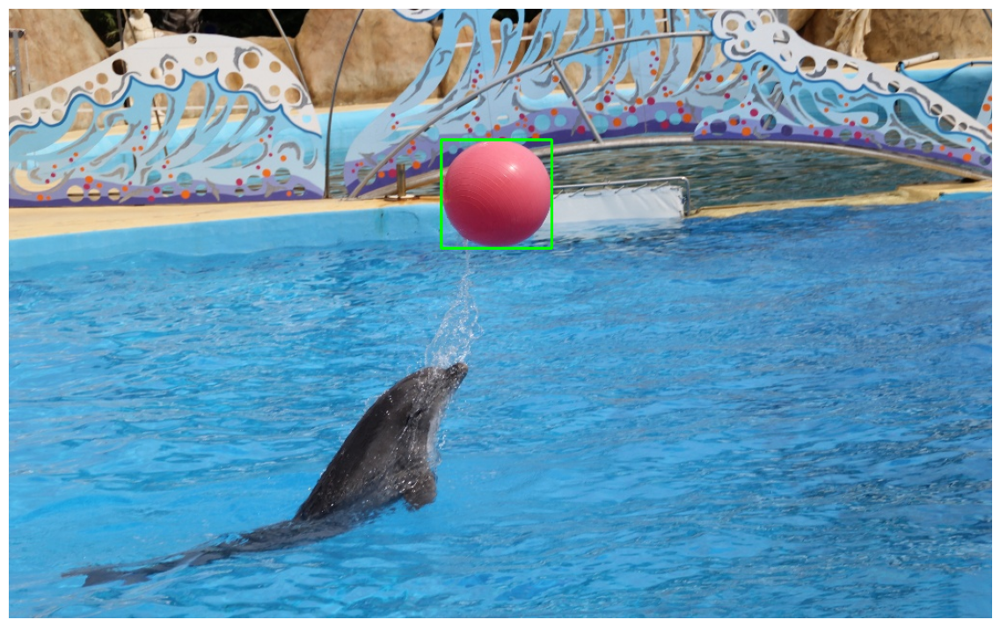

In [ ]:
filename = np.random.choice(train_filenames)
visualize_from_dataset(filename, filename_to_bbox_train_dict)

In [ ]:
val_filenames = list(filename_to_bbox_val_dict.keys())

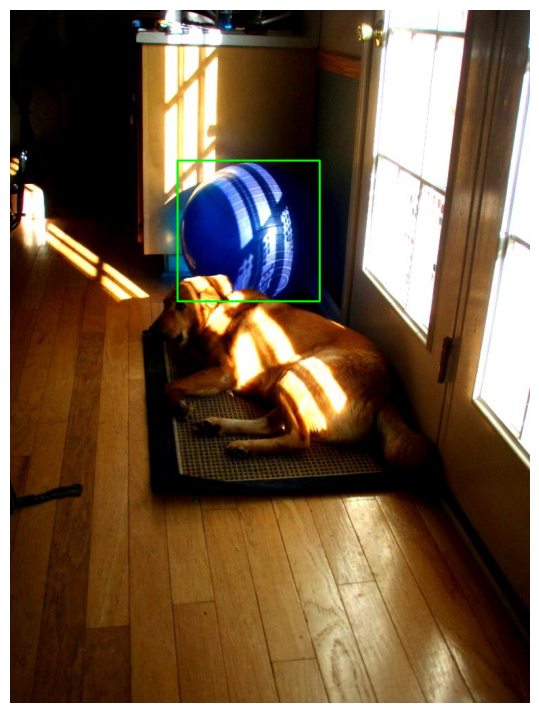

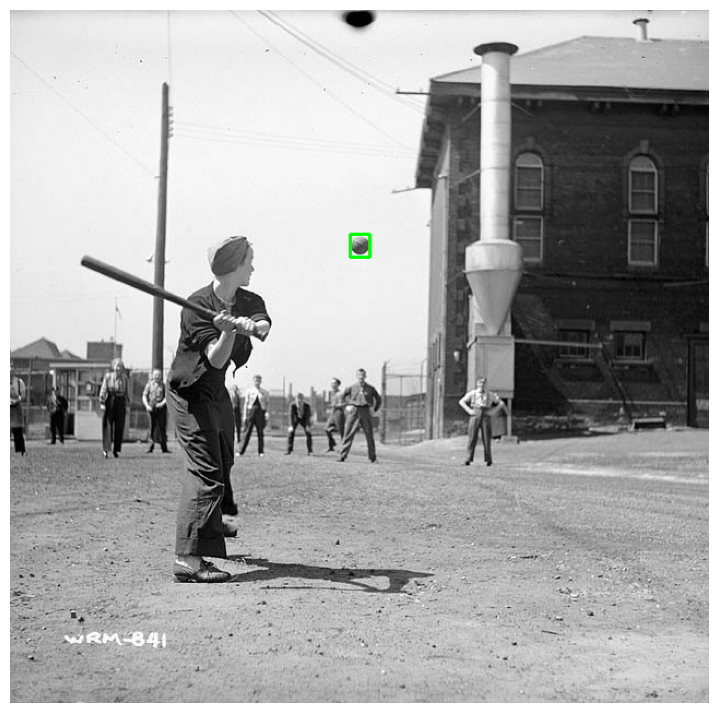

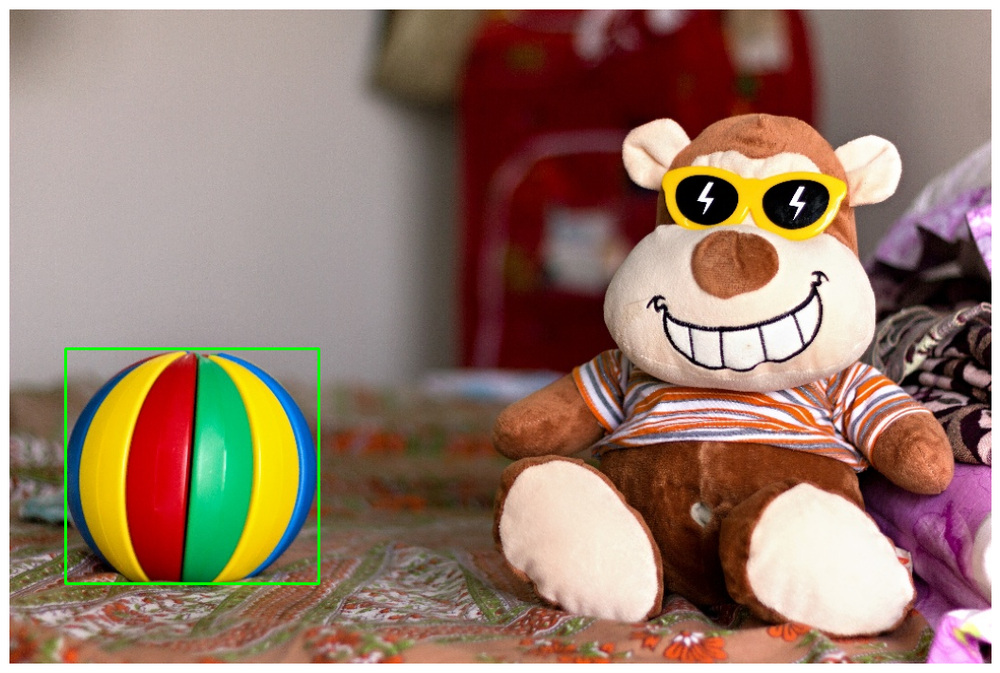

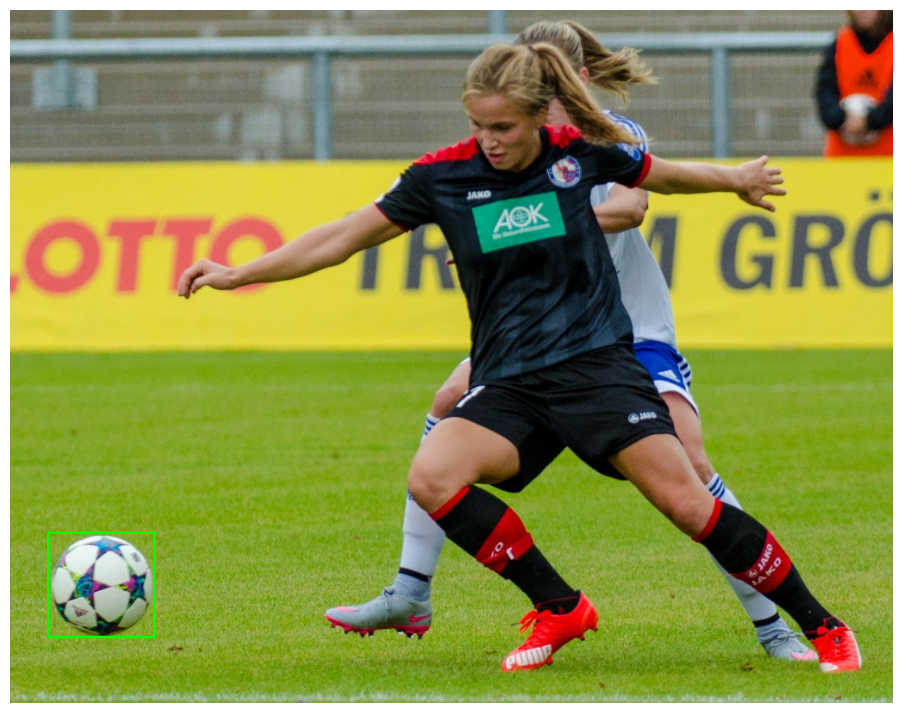

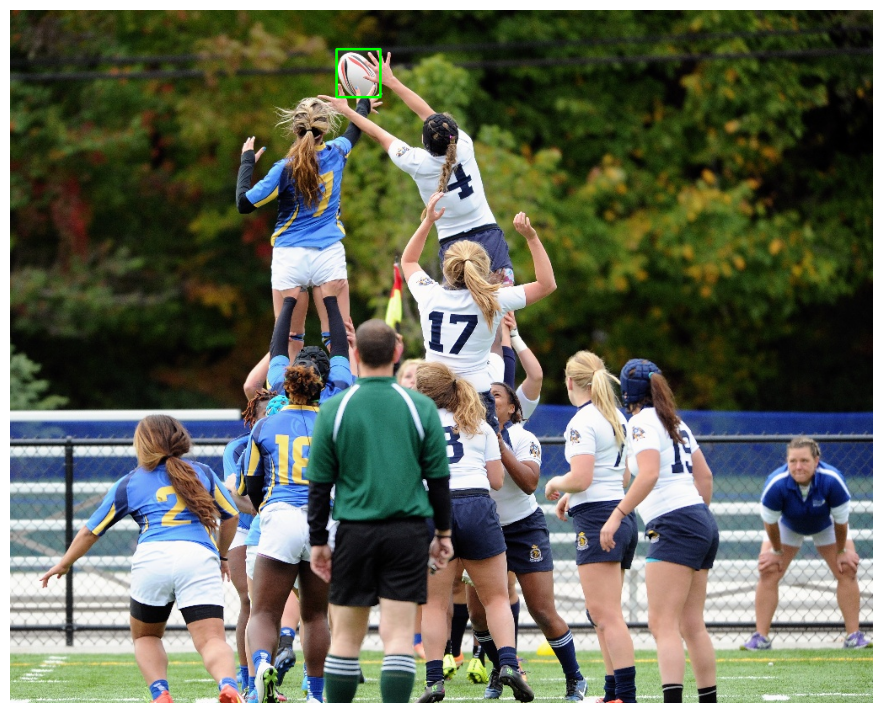

In [ ]:
for filename in np.random.choice(val_filenames, 5):
    visualize_from_dataset(filename, filename_to_bbox_val_dict)

In [ ]:
import torch.utils.data
from torchvision import transforms

class DetectionDataset(torch.utils.data.Dataset):
    def __init__(self, data_dict_file, transforms=None):
        self.transforms = transforms

        with open(data_dict_file, 'r') as f:
            self.data_dict = json.load(f)

        self.imgs = list(self.data_dict.keys())

    def __getitem__(self, idx):
        # load images ad masks
        img_path = self.imgs[idx]
        img = Image.open(img_path).convert("RGB")
        w, h = img.size

        num_objs = len(self.data_dict[img_path])
        boxes = []
        for i in range(num_objs):
            bbox = self.data_dict[img_path][i]
            xmin = bbox[0] * w
            xmax = bbox[1] * w
            ymin = bbox[2] * h
            ymax = bbox[3] * h
            boxes.append([xmin, ymin, xmax, ymax])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        # there is only one class
        labels = torch.ones((num_objs,), dtype=torch.int64)

        image_id = torch.tensor([idx])

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = image_id

        if self.transforms is not None:
            img, target["boxes"], target["labels"] = self.transforms(img, boxes, labels)

        return img, target

    def __len__(self):
        return len(self.imgs)

In [ ]:
class ImgToTensor:
    def __init__(self):
        self.transform = transforms.ToTensor()

    def __call__(self, image, boxes=None, labels=None):
        return self.transform(image), boxes, labels

In [ ]:
# img_transforms = transforms.Compose([
#     transforms.ToTensor()
# ])

In [ ]:
# collate_fn needs for batch
def collate_fn(batch):
    return tuple(zip(*batch))

In [ ]:
# use our dataset and defined transformations
train_dataset = DetectionDataset('oi5_ball_filename_to_bbox_train.json', ImgToTensor())
val_dataset = DetectionDataset('oi5_ball_filename_to_bbox_val.json', ImgToTensor())

In [ ]:
# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=2, shuffle=True, num_workers=4,
    collate_fn=collate_fn, drop_last=True)

data_loader_val = torch.utils.data.DataLoader(
    val_dataset, batch_size=2, shuffle=False, num_workers=1,
    collate_fn=collate_fn, drop_last=False)

In [ ]:
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
# load a model pre-trained pre-trained on COCO
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, pretrained_backbone=True)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:05<00:00, 31.9MB/s]


In [ ]:
num_classes = 2
in_channels = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_channels = in_channels, num_classes = 2)

In [ ]:
assert model.roi_heads.box_predictor.cls_score.in_features == 1024
assert model.roi_heads.box_predictor.cls_score.out_features == 2
assert model.roi_heads.box_predictor.bbox_pred.out_features == 8

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

for param in model.parameters():
    param.requires_grad = True
for param in model.roi_heads.box_predictor.parameters():
    param.requires_grad = True

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)

In [ ]:
device

device(type='cuda')

In [ ]:
model.to(device);

Во время обучение выход модели выглядит так:

loss_dict = model(images, targets)

print (loss_dict)

{'loss_classifier': tensor(1.5606, device='cuda:0', grad_fn=<NllLossBackward>),
 'loss_box_reg': tensor(0.0043, device='cuda:0', grad_fn=<DivBackward0>),
 'loss_objectness': tensor(2.0158, device='cuda:0'),
 'loss_rpn_box_reg': tensor(1.4645, device='cuda:0')}

In [ ]:
!pip install --upgrade git+https://github.com/bes-dev/mean_average_precision.git

  Cloning https://github.com/bes-dev/mean_average_precision.git to /tmp/pip-req-build-f88dmymb
  Running command git clone --filter=blob:none --quiet https://github.com/bes-dev/mean_average_precision.git /tmp/pip-req-build-f88dmymb
  Resolved https://github.com/bes-dev/mean_average_precision.git to commit c30ea439680416f600781022eb6f1f8032d88647
  Preparing metadata (setup.py) ... done


In [ ]:
from mean_average_precision import MetricBuilder

In [ ]:
def add_map(predictions, targets, metric_fn):
    for idx, pred in enumerate(predictions):
        boxes = pred['boxes'].cpu().numpy()
        labels = np.zeros((len(boxes), 1))
        scores = pred['scores'].cpu().numpy().reshape(-1, 1)
        formatted_pred = np.hstack((boxes, labels, scores))

        target = targets[idx]
        true_boxes = target['boxes'].cpu().numpy()
        num_objects = len(true_boxes)
        true_labels = np.zeros((num_objects, 1))
        formatted_target = np.hstack((true_boxes, true_labels, np.zeros((num_objects, 2))))
        metric_fn.add(formatted_pred, formatted_target)

In [ ]:
def calculate_map(model, data_loader):
    model.eval()
    metric_fn = MetricBuilder.build_evaluation_metric("map_2d",
                                                  async_mode=False,
                                                  num_classes=1)
    for images, targets in tqdm(data_loader):
        with torch.no_grad():
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            predictions = model(images)
        add_map(predictions, targets, metric_fn)

    # compute PASCAL VOC metric
    print(f"VOC PASCAL mAP: {metric_fn.value(iou_thresholds=0.5, recall_thresholds=np.arange(0., 1.1, 0.1))['mAP']}")
    # compute PASCAL VOC metric at the all points
    print(f"VOC PASCAL mAP in all points: {metric_fn.value(iou_thresholds=0.5)['mAP']}")
    # compute metric COCO metric
    print(f"COCO mAP: {metric_fn.value(iou_thresholds=np.arange(0.5, 1.0, 0.05), recall_thresholds=np.arange(0., 1.01, 0.01), mpolicy='soft')['mAP']}")

In [ ]:
import math
import sys
from tqdm.notebook import tqdm


def train_one_epoch(model, optimizer, data_loader, device):
    model.train()
    total_loss = 0
    for images, targets in tqdm(data_loader):
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # получим предсказания сети (словарь)
        # cложим их
        loss_dict = model(images, targets)
        losses = sum([value for value in loss_dict.values()])
        loss_value = losses.item()
        total_loss += loss_value

        if not math.isfinite(loss_value):
            print("Loss is {}, stopping training".format(loss_value))
            sys.exit(1)

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
    print("Loss:", total_loss / len(data_loader))
    print("mAP calculation...")
    calculate_map(model, data_loader_val)

In [ ]:
num_epochs = 2
for epoch in range(num_epochs):
    print(f"========Epoch {epoch}=========")
    train_one_epoch(model, optimizer, data_loader, device)

========Epoch 0=========


  0%|          | 0/1437 [00:00<?, ?it/s]

Loss: 0.23142756244314155
mAP calculation...


  0%|          | 0/113 [00:00<?, ?it/s]

VOC PASCAL mAP: 0.6469221115112305
VOC PASCAL mAP in all points: 0.6717037558555603
COCO mAP: 0.43306511640548706
========Epoch 1=========


  0%|          | 0/1437 [00:00<?, ?it/s]

Loss: 0.17099376066108918
mAP calculation...


  0%|          | 0/113 [00:00<?, ?it/s]

VOC PASCAL mAP: 0.7420285940170288
VOC PASCAL mAP in all points: 0.763610303401947
COCO mAP: 0.4756336808204651


In [ ]:
to_tensor = transforms.ToTensor()

def val_transform(img):
    img_tensor = to_tensor(img)
    return img_tensor.unsqueeze(0)

In [ ]:
def visualize_prediction_plate(file, model, device='cuda', verbose=False, thresh=0.0,
                               n_colors=None, id_to_name=None):
    img = Image.open(file)
    img_tensor = val_transform(img)
    model.to(device)
    model.eval()
    with torch.no_grad():
        predictions = model(img_tensor.to(device)) # list of size 1
    prediction = predictions[0]

    if n_colors is None:
        n_colors = model.roi_heads.box_predictor.cls_score.out_features

    palette = sns.color_palette(None, n_colors)

    # visualize
    img = cv2.imread(file, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    image = img
    for i in range(len(prediction['boxes'])):
        x_min, y_min, x_max, y_max = map(int, prediction['boxes'][i].tolist())
        label = int(prediction['labels'][i].cpu())
        score = float(prediction['scores'][i].cpu())
        name = id_to_name[label]
        color = palette[label]
        if verbose:
            if score > thresh:
                print ('Class: {}, Confidence: {}'.format(name, score))
        if score > thresh:
            image = cv2.rectangle(img, (x_min, y_min), (x_max, y_max), np.array(color) * 255, 2)
            cv2.putText(image, name, (x_min, y_min-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, np.array(color) * 255, 2)
    show_image(image)
#     return prediction

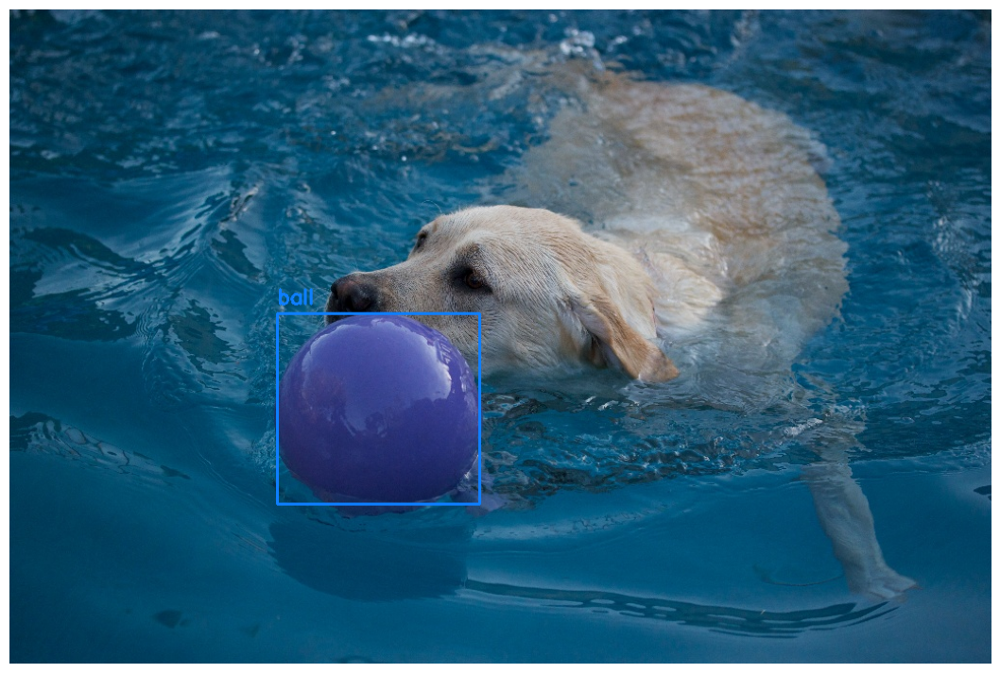

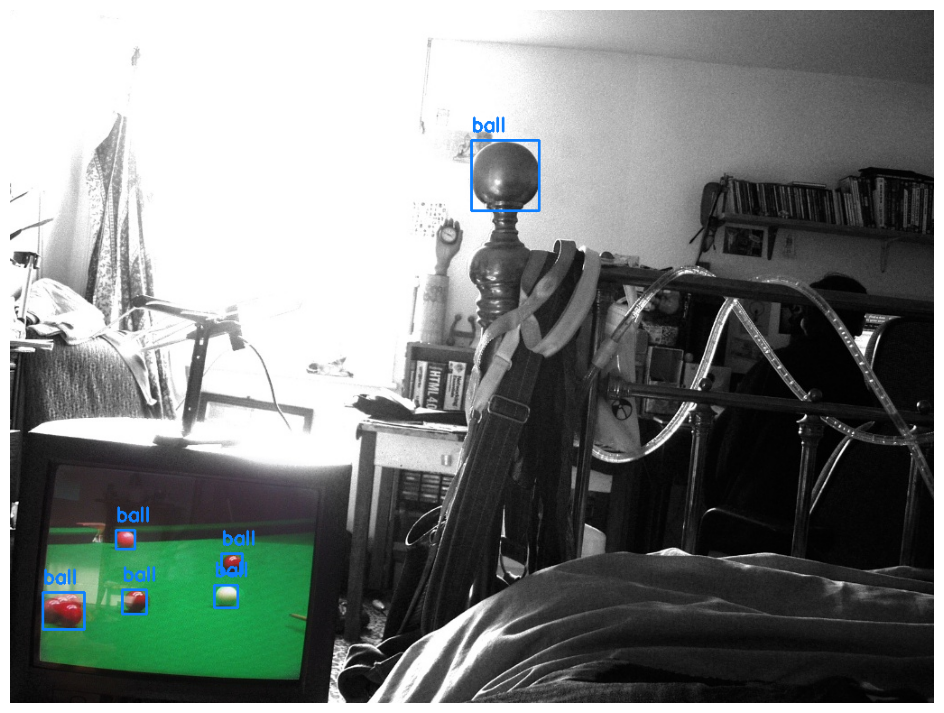

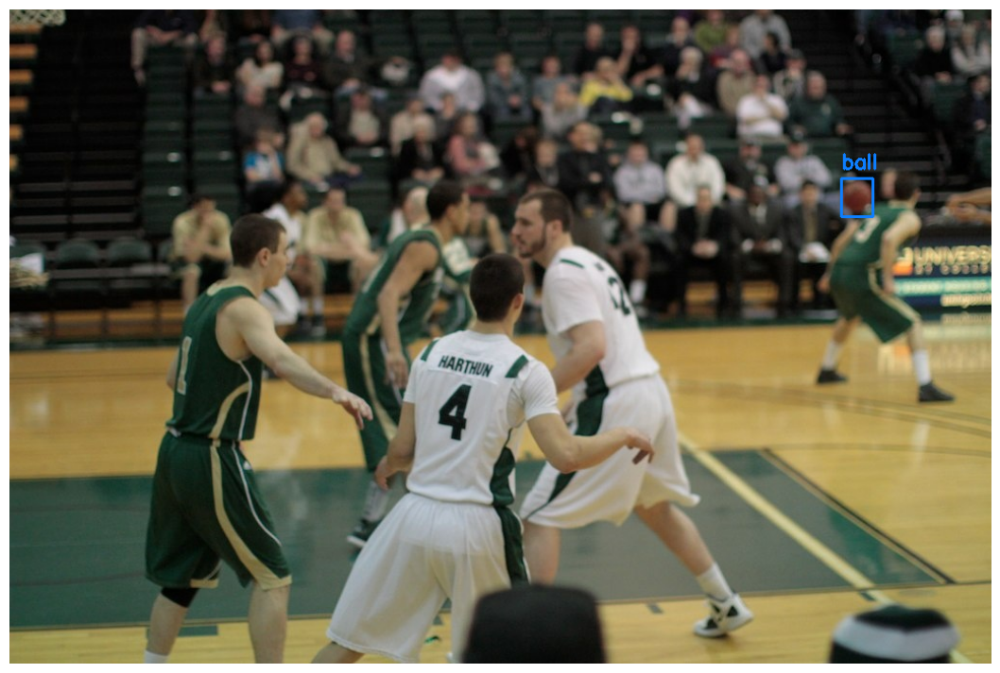

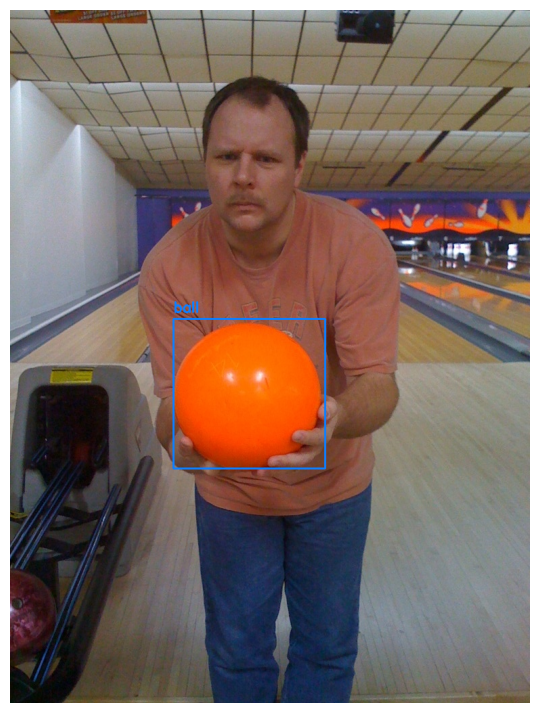

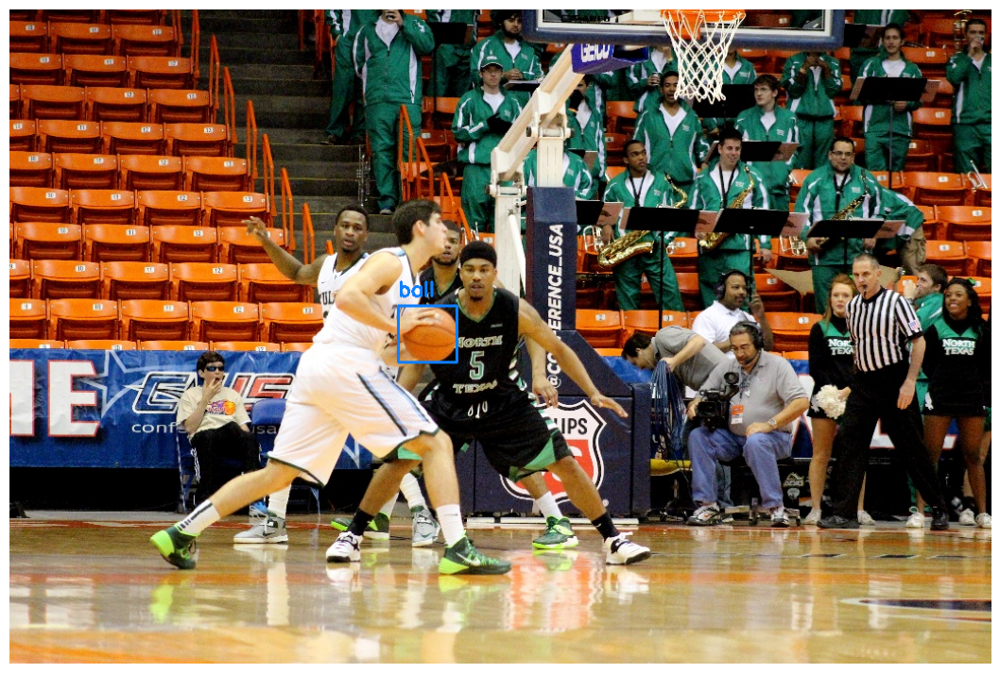

In [ ]:
for i in range(5):
  filename = np.random.choice(val_filenames)
  visualize_prediction_plate(filename, model, id_to_name={1: 'ball'}, thresh=0.7)

### Применим аугментации

In [ ]:
from numpy import random

In [ ]:
class RandomMirror(object):
    def __call__(self, image, boxes, classes):
        _, width, _ = image.shape
        if random.randint(2):
            image = torch.flip(image, dims=[2])
            boxes[:, 0], boxes[:, 2] = width - boxes[:, 2], width - boxes[:, 0]
        return image, boxes, classes

In [ ]:
class RandomSaturation(object):
    def __init__(self, lower=0.5, upper=1.5):
        self.lower = lower
        self.upper = upper
        assert self.upper >= self.lower, "contrast upper must be >= lower."
        assert self.lower >= 0, "contrast lower must be non-negative."

    def __call__(self, image, boxes=None, labels=None):
        if random.randint(2):
            image[:, :, 1] *= random.uniform(self.lower, self.upper)

        return image, boxes, labels

In [ ]:
class Compose(object):
    """Composes several augmentations together.
    Args:
        transforms (List[Transform]): list of transforms to compose.
    Example:
        >>> Compose([
        >>>     transforms.CenterCrop(10),
        >>>     transforms.ToTensor(),
        >>> ])
    """

    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, img, boxes=None, labels=None):
        for t in self.transforms:
            img, boxes, labels = t(img, boxes, labels)
        return img, boxes, labels

In [ ]:
class Augmentation(object):
    def __init__(self):
        self.augment = Compose([
            ImgToTensor(),
            RandomMirror(),
            RandomSaturation(),
        ])

    def __call__(self, img, boxes, labels):
        return self.augment(img, boxes, labels)

In [ ]:
# use our dataset and defined transformations
train_dataset = DetectionDataset('oi5_ball_filename_to_bbox_train.json', Augmentation())
val_dataset = DetectionDataset('oi5_ball_filename_to_bbox_val.json', ImgToTensor())

In [ ]:
# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=2, shuffle=True,
    collate_fn=collate_fn, drop_last=True)

data_loader_val = torch.utils.data.DataLoader(
    val_dataset, batch_size=2, shuffle=False,
    collate_fn=collate_fn, drop_last=False)

In [ ]:
aug_model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, pretrained_backbone=True)
num_classes = 2
in_channels = aug_model.roi_heads.box_predictor.cls_score.in_features
aug_model.roi_heads.box_predictor = FastRCNNPredictor(in_channels = in_channels, num_classes = 2)

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

for param in aug_model.parameters():
    param.requires_grad = True
for param in aug_model.roi_heads.box_predictor.parameters():
    param.requires_grad = True

# construct an optimizer
aug_params = [p for p in aug_model.parameters() if p.requires_grad]
aug_optimizer = torch.optim.SGD(aug_params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)

aug_model.to(device);

In [ ]:
num_epochs = 2
for epoch in range(num_epochs):
    print(f"========Epoch {epoch}=========")
    train_one_epoch(aug_model, aug_optimizer, data_loader, device)

========Epoch 0=========


  0%|          | 0/1437 [00:00<?, ?it/s]

Loss: 0.4143009968387143
mAP calculation...


  0%|          | 0/113 [00:00<?, ?it/s]

VOC PASCAL mAP: 0.6888253688812256
VOC PASCAL mAP in all points: 0.7055429220199585
COCO mAP: 0.40885066986083984
========Epoch 1=========


  0%|          | 0/1437 [00:00<?, ?it/s]

Loss: 0.35159953972668223
mAP calculation...


  0%|          | 0/113 [00:00<?, ?it/s]

VOC PASCAL mAP: 0.6797795295715332
VOC PASCAL mAP in all points: 0.7059072852134705
COCO mAP: 0.4540974199771881


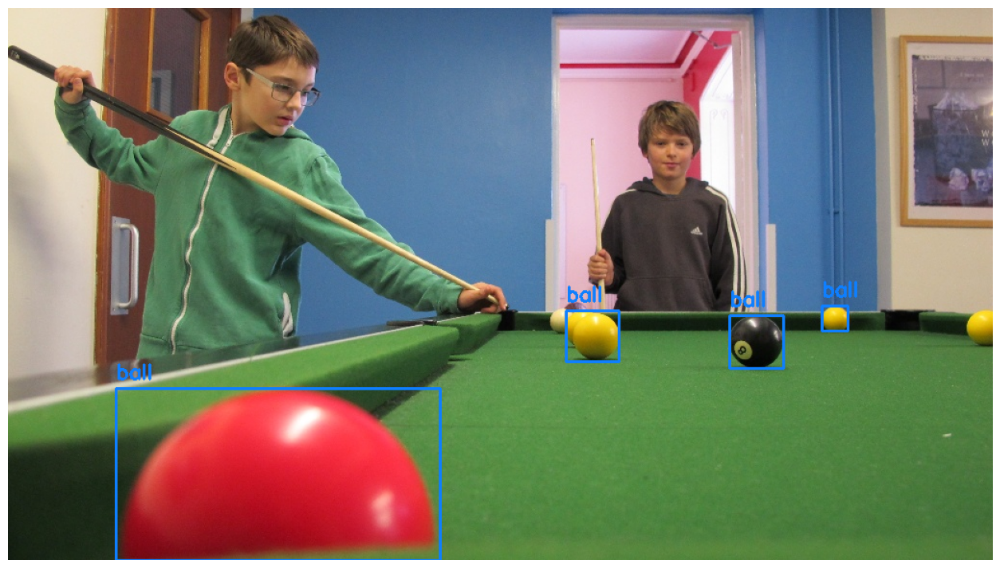

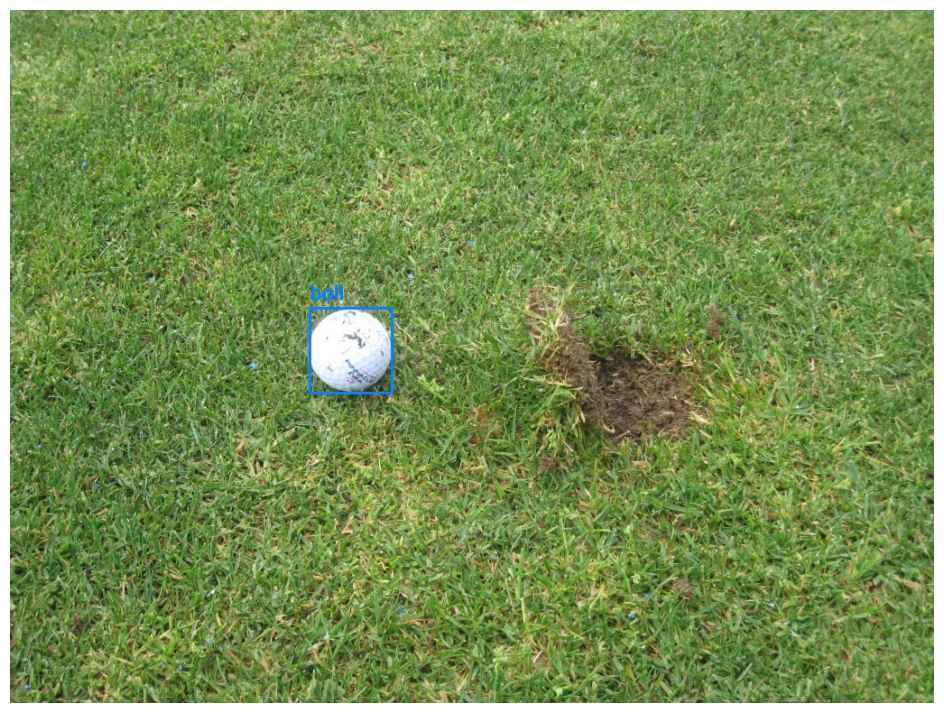

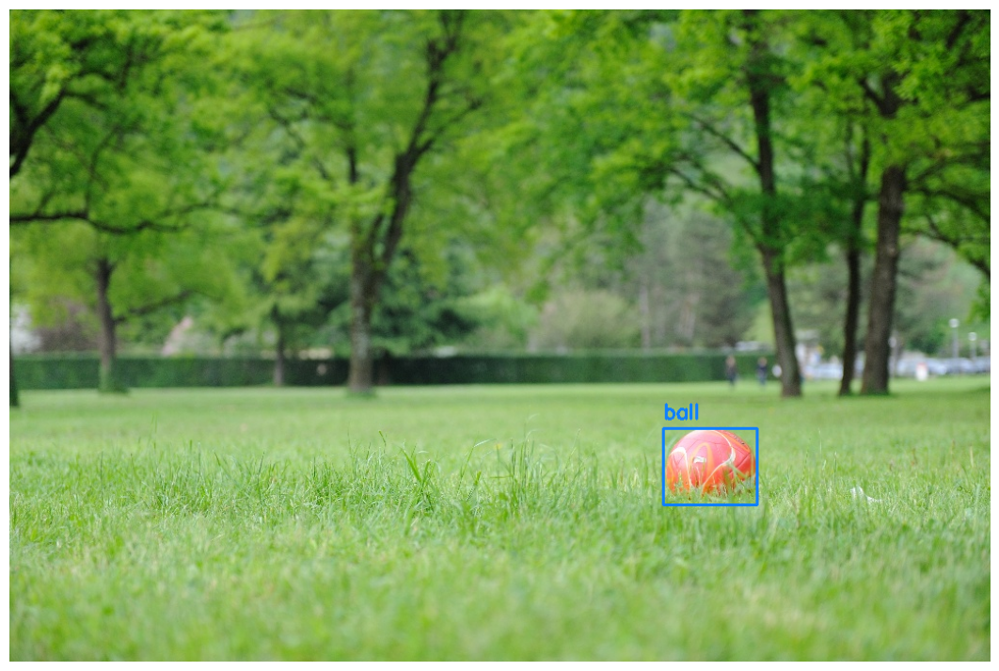

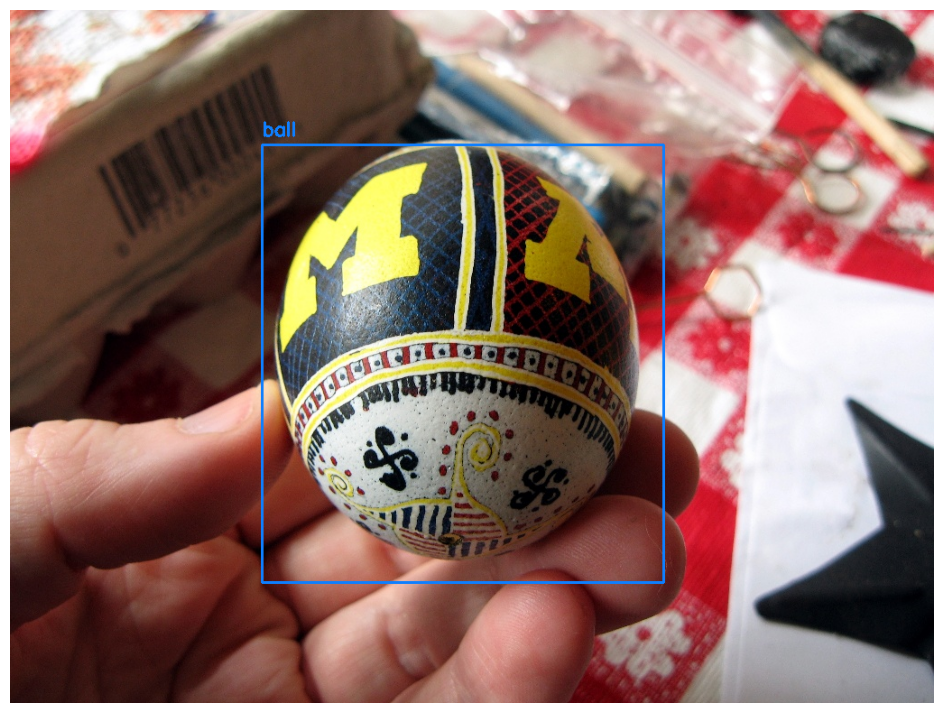

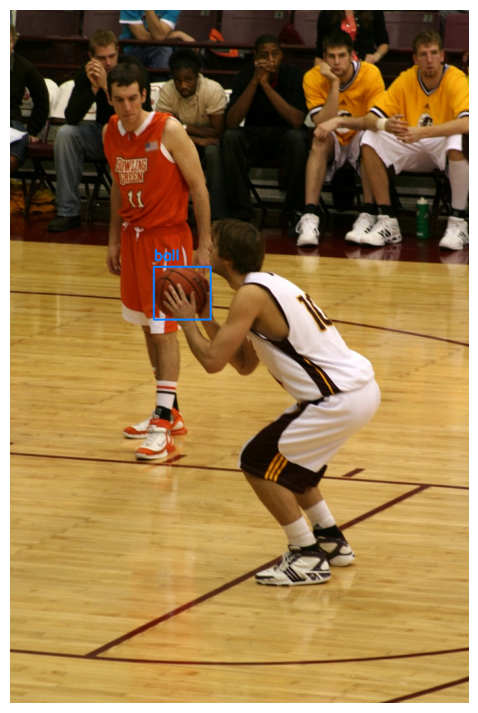

In [ ]:
for i in range(5):
  filename = np.random.choice(val_filenames)
  visualize_prediction_plate(filename, aug_model, id_to_name={1: 'ball'}, thresh=0.7)